In [1]:
import taichi as ti
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import animation
from tqdm.notebook import tqdm
from IPython.display import HTML

from acoustic_no.fdtd_solver.grid import Grid2D
from acoustic_no.fdtd_solver.object import Circle
from acoustic_no.fdtd_solver.solver import Solver2D
from acoustic_no.utils.audio_utils import generate_audio_clip

[Taichi] version 1.7.3, llvm 15.0.7, commit 5ec301be, osx, python 3.12.9


[I 05/14/25 02:20:58.556 36069086] [shell.py:_shell_pop_print@23] Graphical python shell detected, using wrapped sys.stdout


In [2]:
ti.init(ti.gpu)

[Taichi] Starting on arch=metal


In [3]:
grid_size = (64, 64)
cell_size = 1 / 64
step_size = 1 / 44100
wave_speed = 340
blend_dist = 1
length = 1

In [4]:
grid = Grid2D(grid_size, cell_size, step_size, wave_speed)
solver = Solver2D(grid, 0.0001, 8, 0.05, blend_dist)

In [5]:
# Animated audio source.
t_frames = np.array([0, length], dtype=np.float32)
center = np.array(
    [
        [0.25, 0.5],
        [0.75, 0.5],
    ]
)
radius = np.array([0.1, 0.1], dtype=np.float32)
source = Circle(t_frames, center, radius)
# Generate random audio.
SAMPLE_RATE = 44100
NUM_FREQS = 3
NUM_CLIPS = 1
clip_length = length / NUM_CLIPS
t = np.array([])
sample = np.array([])
for i in range(NUM_CLIPS):
    freqs = np.random.uniform(20, 2000, size=(NUM_FREQS,))
    amps = np.random.uniform(0, 1, size=(NUM_FREQS,))
    t_clip, sample_clip = generate_audio_clip(
        zip(freqs, amps), SAMPLE_RATE, clip_length
    )
    t_clip += i * clip_length
    t = np.concatenate((t, t_clip))
    sample = np.concatenate((sample, sample_clip))
# Normalize audio.
sample = sample / np.max(np.abs(sample))
sample = 0.25 * sample
# Load audio.
source.load_audio_sample(SAMPLE_RATE, sample)
# Add source to scene.
solver.objects.append(source)

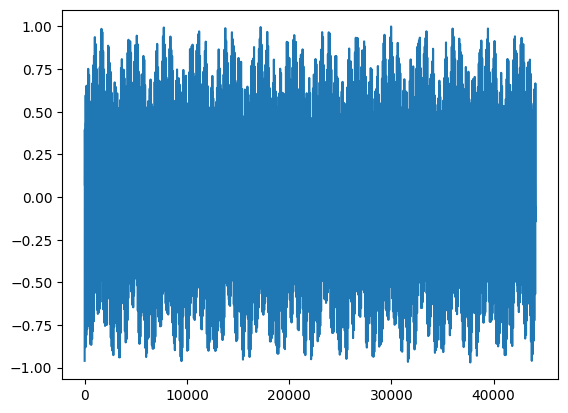

In [6]:
plt.plot(source.normal_v)

In [7]:
# Simulate 1024 steps.
STEPS = 1024
pressure_arr = np.zeros((STEPS, grid_size[0], grid_size[1]), dtype=np.float32)
alpha_arr = np.zeros((STEPS, grid_size[0], grid_size[1]), dtype=np.float32)
velocity_arr = np.zeros((STEPS, grid_size[0], grid_size[1], 2), dtype=np.float32)

for frame in tqdm(range(0, STEPS)):
    solver.step()
    curr_pressure = grid.p_grid.to_numpy(np.float32)
    curr_alpha = grid.alpha_grid.to_numpy(np.float32)
    curr_velocity = grid.v_grid.to_numpy(np.float32).reshape(grid_size[0], grid_size[1], 2)
    pressure_arr[frame] = curr_pressure
    alpha_arr[frame] = curr_alpha
    velocity_arr[frame] = curr_velocity

  0%|          | 0/1024 [00:00<?, ?it/s]

Animation Progress:   0%|          | 0/1024 [00:00<?, ?step/s]

INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


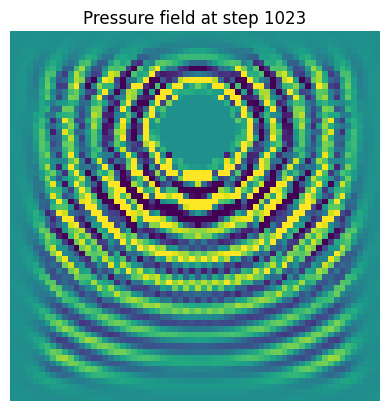

In [10]:
# Tqdm progress bar for the simulation
pbar = tqdm(total=STEPS, desc="Animation Progress", unit="step")

# Generate the animation for the pressure field.
def update(frame):
    ax.clear()
    im = ax.imshow(
        pressure_arr[frame],
        interpolation='nearest',
        vmin=-10.0,
        vmax=10.0
    )
    ax.set_title(f'Pressure field at step {frame}')
    ax.axis('off')
    # Update the progress bar
    pbar.update(1)
    # Close the progress bar when done
    if frame == STEPS - 1:
        pbar.close()
    return [im]

fig, ax = plt.subplots()

# Wrap the animation generation with tqdm for progress tracking
ani = animation.FuncAnimation(
    fig,
    update,
    frames=range(STEPS),
    interval=1000 / 60,
    blit=False,
    repeat=True,
)

# Display the animation in the notebook
HTML(ani.to_jshtml())

Velocity Animation:   0%|          | 0/1024 [00:00<?, ?frame/s]

INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


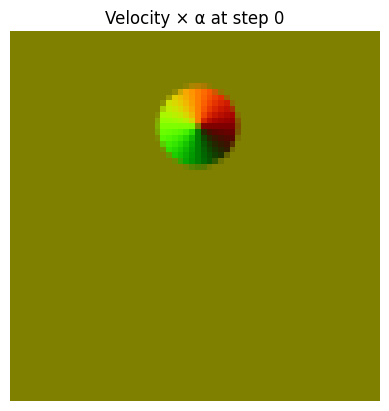

In [11]:
# precompute global max magnitude for normalization (scale velocity by alpha)
vel_mag = np.linalg.norm(velocity_arr * alpha_arr[..., None], axis=-1)
vel_max = vel_mag.max()

# tqdm for velocity animation
pbar_vel = tqdm(total=STEPS, desc="Velocity Animation", unit="frame")

def update_vel(frame):
    ax2.clear()
    # extract and scale by alpha
    vx = velocity_arr[frame, ..., 0] * alpha_arr[frame]
    vy = velocity_arr[frame, ..., 1] * alpha_arr[frame]
    # normalize to [-1, 1]
    vx_n = vx / vel_max
    vy_n = vy / vel_max
    # map to [0,1] for RGB channels: x→red, y→green
    R = (vx_n + 1) / 2
    G = (vy_n + 1) / 2
    B = np.zeros_like(R)
    img = np.stack([R, G, B], axis=-1)
    im2 = ax2.imshow(img, interpolation='nearest')
    ax2.set_title(f'Velocity × α at step {frame}')
    ax2.axis('off')
    pbar_vel.update(1)
    if frame == STEPS - 1:
        pbar_vel.close()
    return [im2]

fig2, ax2 = plt.subplots()
ani_vel = animation.FuncAnimation(
    fig2,
    update_vel,
    frames=range(STEPS),
    interval=1000 / 60,  # 60 fps
    blit=False,
    repeat=True,
)

# display in notebook
HTML(ani_vel.to_jshtml())